In [300]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer #  Tf–idf
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.decomposition import PCA

import nltk
from nltk.corpus import stopwords
from gensim.models import Word2Vec # Word2Vec
from gensim.models import FastText # FastText
from gensim.models import Phrases
from nltk.tokenize import word_tokenize
from nltk import ngrams
import string
from collections import Counter

import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns

In [4]:
df = pd.read_csv('clean_text.csv', index_col=0)

In [6]:
df.head()

,url,title,theme,tags,read_time,number_of_views,date,amount_of_imgs,comments,bookmark,votes,text
0,https://habr.com/ru/articles/842474/,На Alibaba можно купить станок для изготовлени...,Научно-популярное,"['Научно-популярное', 'Физика']",4,2800,2024-09-11 14:58:00,0,4,3,0,производство бриллиант стать дешёвый чем когда...
1,https://habr.com/ru/articles/842336/,"Учёные, искавшие жизнь на Марсе, услышали сигн...",Научно-популярное,"['Научно-популярное', 'Астрономия']",8,1600,2024-09-11 13:38:00,0,1,2,0,в год радиоприёмник создать для поле сражение ...
2,https://habr.com/ru/companies/montirey/article...,Проявление свойств эфира: доказано эксперимент...,Блог компании Мон Тирэй,"['Блог компании Мон Тирэй', 'Научно-популярное...",7,3700,2024-09-11 11:24:00,0,44,5,0,исследование российский учёный подтвердить сущ...
3,https://habr.com/ru/companies/timeweb/articles...,Деннис Макалистэйр Ритчи. Между Unix и С / Хабр,Блог компании Timeweb Cloud,"['Блог компании Timeweb Cloud', 'Читальный зал...",18,1300,2024-09-11 11:05:00,0,0,11,0,создатель точнее весь описывать ритча именно э...
4,https://habr.com/ru/articles/842324/,Болезнь Альцгеймера может оказаться аутоиммунн...,Научно-популярное,"['Научно-популярное', 'Мозг', 'Здоровье']",4,840,2024-09-11 10:49:00,0,0,4,0,поиск лекарство от болезнь альцгеймер становит...


In [11]:
stop_list = stopwords.words("russian")
stop_list.extend(['это', 'который', 'всё', 'весь', 'свой', 'наш', 'ещё', 'также', 'год', 'c', 'е', 'с', 'e', 'b', 'a', 'gb', 'd'])

In [15]:
def preprocess(text):
    tokens = word_tokenize(text)
    tokens = [word for word in tokens if word not in stop_list]
    return ' '.join(tokens)

In [18]:
df['text'] = df['text'].map(lambda x: preprocess(x))

In [ ]:
# df.to_csv('del_stop_words.csv')
df = pd.read_csv('del_stop_words.csv', index_col=0)

# Удаляем слова, которые встречаются слишком часто, либо слишком редко

In [69]:
corpus = Counter((' '.join(df['text'])).split())
corpus_ = [(key, value) for key, value in corpus.items()]
sorted(corpus_, key=lambda x: x[1], reverse=True)[:15]

[('мочь', 40513),
 ('время', 23582),
 ('человек', 22046),
 ('система', 18196),
 ('первый', 15927),
 ('большой', 14974),
 ('новый', 13444),
 ('работа', 12925),
 ('стать', 12442),
 ('использовать', 12221),
 ('очень', 11564),
 ('самый', 11554),
 ('иметь', 11439),
 ('являться', 11071),
 ('каждый', 11002)]

In [46]:
corpus_ = [(key, value) for key, value in corpus.items()]
sorted(corpus_, key=lambda x: x[1])

[('javid', 1),
 ('lakha', 1),
 ('нэглый', 1),
 ('nagle', 1),
 ('animats', 1),
 ('производствохотя', 1),
 ('перенасыщениеиногда', 1),
 ('tomra', 1),
 ('развес', 1),
 ('небьющийся', 1),
 ('распалить', 1),
 ('марсомания', 1),
 ('радиофотосообщение', 1),
 ('радиовселенная', 1),
 ('средытеория', 1),
 ('первовещество', 1),
 ('задачать', 1),
 ('исследованийметод', 1),
 ('далькаровый', 1),
 ('плоскопараллельный', 1),
 ('экспериментавый', 1),
 ('фоторегистрация', 1),
 ('шареследующий', 1),
 ('меняйло', 1),
 ('тимошина', 1),
 ('эфираисследовать', 1),
 ('виброизолирующий', 1),
 ('карапуз', 1),
 ('субрекурсивный', 1),
 ('работалва', 1),
 ('ритчивый', 1),
 ('поигрывать', 1),
 ('шэг', 1),
 ('грец', 1),
 ('musuem', 1),
 ('unixкак', 1),
 ('besys', 1),
 ('dmr', 1),
 ('unics', 1),
 ('uniplexed', 1),
 ('ossannaещ', 1),
 ('оссанный', 1),
 ('форматировщик', 1),
 ('roff', 1),
 ('машинистка', 1),
 ('монтирование', 1),
 ('размонтирование', 1),
 ('алы', 1),
 ('неиерархический', 1),
 ('сопрограмма', 1),
 ('lion

In [65]:
# 76_830 слов встречается всего 1 раз во всех текстах
# 157_459 уникальных слов в текстах

corpus_len = {}

for key, value in corpus.items():
    if not value in corpus_len:
        corpus_len[value] = 0
    corpus_len[value] += 1

corpus_len = [(key, value) for key, value in corpus_len.items()]
sorted(corpus_len, key=lambda x: x[1], reverse=True)[:40]

[(1, 76830),
 (2, 18573),
 (3, 10038),
 (4, 6257),
 (5, 4546),
 (6, 3584),
 (7, 2842),
 (8, 2318),
 (9, 1961),
 (10, 1658),
 (11, 1440),
 (12, 1353),
 (13, 1188),
 (14, 965),
 (15, 900),
 (16, 810),
 (17, 791),
 (18, 682),
 (19, 637),
 (20, 593),
 (22, 547),
 (21, 533),
 (23, 488),
 (24, 463),
 (25, 404),
 (26, 392),
 (27, 377),
 (29, 366),
 (28, 355),
 (30, 349),
 (31, 310),
 (33, 297),
 (34, 284),
 (32, 271),
 (35, 267),
 (36, 255),
 (37, 241),
 (38, 225),
 (41, 206),
 (40, 203)]

In [52]:
len(corpus)

157459

In [53]:
sum([i[1] for i in corpus_len])

157459

In [66]:
corpus_len = {}
words = {}

for key, value in corpus.items():
    if not value in corpus_len:
        corpus_len[value] = 0

    if not value in words:
        words[value] = []
        
    corpus_len[value] += 1
    words[value].append(key)

In [76]:
del_words = []

for i in range(1, 24):
    del_words.extend(words[i])

del_words.extend(['мочь'])
len(del_words)

139535

In [92]:
d_words = set(del_words)

def remove_words(text):
    tokens = [word for word in text.split() if word not in d_words]
    return ' '.join(tokens)

In [97]:
%%time
df['text'][:1].map(lambda x: remove_words(x)) # words in set

CPU times: user 378 μs, sys: 1 μs, total: 379 μs
Wall time: 382 μs


0    производство бриллиант стать дешёвый либо созд...
Name: text, dtype: object

In [98]:
df['text'] = df['text'].map(lambda x: remove_words(x))

In [101]:
df['text'].map(lambda x: len(x.split())).describe()

count     4337.000000
mean      1206.523403
std        859.305958
min         13.000000
25%        665.000000
50%       1023.000000
75%       1492.000000
max      14234.000000
Name: text, dtype: float64

In [2]:
# df.to_csv('del_freq_words.csv')
df = pd.read_csv('del_freq_words.csv', index_col=0)

In [277]:
def draw_error(error_list, labels):
    ticks = np.arange(len(error_list))
    fig = plt.figure(figsize=(20, 5))
    ax = fig.add_subplot()
    ax.plot(error_list, marker='.', label = 'Ошибка')
    ax.set_title('Ошибка')
    ax.xaxis.set_major_locator(ticker.FixedLocator(ticks))
    ax.set_xticklabels(labels)
    ax.legend()
    ax.grid()

# TF-IDF

In [337]:
X = df['text'].to_list()

In [340]:
tfidf_vectorizer = TfidfVectorizer(min_df=1, use_idf=True, norm=None, ngram_range=(1, 2)) # No normalization, униграммы и биграммы
tfidf_vec = tfidf_vectorizer.fit_transform(X)
tfidf_vec.shape

(4337, 2794711)

In [342]:
dict(zip(tfidf_vectorizer.vocabulary_, tfidf_vectorizer.idf_)), len(tfidf_vectorizer.vocabulary_)

({'производство': 6.430729712220379,
  'бриллиант': 8.276556402718711,
  'стать': 8.276556402718711,
  'дешёвый': 8.682021510826875,
  'либо': 8.682021510826875,
  'создавать': 8.682021510826875,
  'странный': 8.682021510826875,
  'проблема': 8.682021510826875,
  'слишком': 8.682021510826875,
  'эпоха': 8.682021510826875,
  'интернет': 8.682021510826875,
  'купить': 8.682021510826875,
  'практически': 8.682021510826875,
  'угодный': 8.682021510826875,
  'удивительный': 8.682021510826875,
  'китайский': 8.682021510826875,
  'сайт': 8.682021510826875,
  'электронный': 8.682021510826875,
  'коммерция': 8.682021510826875,
  'приобрести': 8.682021510826875,
  'станок': 8.682021510826875,
  'изготовление': 8.682021510826875,
  'обращать': 8.682021510826875,
  'внимание': 8.682021510826875,
  'алмазный': 8.682021510826875,
  'промышленность': 5.463145685958674,
  'оказаться': 8.276556402718711,
  'доступность': 8.682021510826875,
  'машина': 7.988874330266929,
  'отражать': 8.682021510826875,

# Test

In [190]:
text_len = 7
vector_size = 5

In [229]:
from sklearn.feature_extraction.text import TfidfVectorizer
corpus = ["This is very strange",
          "This is very nice, very nice, very nice and nice not nice"]
vectorizer = TfidfVectorizer(min_df=1, use_idf=True, ngram_range=(1, 2))
X = vectorizer.fit_transform(corpus)
idf = vectorizer.idf_
print(dict(zip(vectorizer.vocabulary_, idf))), len(vectorizer.vocabulary_), len(idf)

{'this': 1.4054651081081644, 'is': 1.4054651081081644, 'very': 1.0, 'strange': 1.0, 'this is': 1.4054651081081644, 'is very': 1.4054651081081644, 'very strange': 1.4054651081081644, 'nice': 1.4054651081081644, 'and': 1.4054651081081644, 'not': 1.4054651081081644, 'very nice': 1.4054651081081644, 'nice very': 1.0, 'nice and': 1.0, 'and nice': 1.0, 'nice not': 1.4054651081081644, 'not nice': 1.4054651081081644}


(None, 16, 16)

In [232]:
corp = [sentence.split() for sentence in corpus]
bigram_transformer = Phrases(corp, min_count=1, threshold=1)
t_model = Word2Vec(bigram_transformer[corp], vector_size=vector_size, window=5, min_count=1, workers=4)

In [233]:
t_model.wv.key_to_index

{'nice': 0,
 'very_nice,': 1,
 'very': 2,
 'This_is': 3,
 'not': 4,
 'and': 5,
 'strange': 6}

In [377]:
class TextToVector:
    def __init__(self, model, text_len, vector_size, is_fasttext = False):
        self._model = model
        self._text_len = text_len
        self._vector_size = vector_size
        self._is_fasttext = is_fasttext

    def _convert_one(self, sentence):
        vector = np.zeros((self._text_len, self._vector_size))
        words = sentence.split()+[None, None]
        n_grams = []
        
        i = 0
        j = 0
        seq_len = len(words)-2 if len(words)-2 < self._text_len else self._text_len
        
        while i < seq_len:
            seq = f'{words[i]}_{words[i+1]}'
            res, seq = self._check(seq)
            if res and not self._is_fasttext:
                i+=1
                vector[j] = seq
                n_grams.append(f'{words[i]} {words[i+1]}') # for tf-idf without '_'
            else:
                _, seq = self._check(words[i])
                vector[j] = seq
                n_grams.append(words[i])

            j+=1
            i+=1

        return vector, n_grams

    def _check(self, seq):
        if seq in self._model.wv:
            return True, self._model.wv[seq]
        else:
            return False, np.zeros(self._vector_size)

    def convert(self, text):
        vectors = []
        n_grams = []
        for i in text:
            vector, n_gram = self._convert_one(i)
            vectors.append(vector)
            n_grams.append(n_gram)
        
        return np.array(vectors), n_grams

In [238]:
t2v = TextToVector(t_model, text_len, vector_size)
X_vec = t2v.convert(corpus)
X_vec, X_vec[0].shape

((array([[[-0.03632035,  0.0575316 ,  0.01983747, -0.1657043 ,
           -0.18897636],
          [ 0.1476101 , -0.03066943, -0.09073226,  0.13108103,
           -0.09720321],
          [-0.15023164, -0.01860085,  0.19076237, -0.14638333,
           -0.04667537],
          [ 0.        ,  0.        ,  0.        ,  0.        ,
            0.        ],
          [ 0.        ,  0.        ,  0.        ,  0.        ,
            0.        ],
          [ 0.        ,  0.        ,  0.        ,  0.        ,
            0.        ],
          [ 0.        ,  0.        ,  0.        ,  0.        ,
            0.        ]],
  
         [[-0.03632035,  0.0575316 ,  0.01983747, -0.1657043 ,
           -0.18897636],
          [-0.14233617,  0.12917745,  0.17945977, -0.10030856,
           -0.07526743],
          [-0.14233617,  0.12917745,  0.17945977, -0.10030856,
           -0.07526743],
          [ 0.1476101 , -0.03066943, -0.09073226,  0.13108103,
           -0.09720321],
          [ 0.        ,  0. 

In [343]:
class To1Vec:
    def __init__(self, tfidf_vec):
        self.tfidf = tfidf_vec
        self.vocab = dict(zip(self.tfidf.vocabulary_, self.tfidf.idf_))

    def _convert_one(self, vectors, n_grams):
        result = np.zeros(vectors.shape[1])
        for vec, n_gram in zip(vectors, n_grams):
            if n_gram in self.vocab:
                result += vec * self.vocab[n_gram]
                # print(vec * self.vocab[n_gram], n_gram)

        return result

    def convert(self, vector, n_grams):
        return np.array([self._convert_one(v, g) for v, g in zip(vector, n_grams)])
        

In [263]:
to1vec = To1Vec(vectorizer)
to1vec.convert(X_vec[0], X_vec[1])

[-0.05104699  0.08085865  0.02788088 -0.2328916  -0.26559968] is very
[ 0.1476101  -0.03066943 -0.09073226  0.13108103 -0.09720321] very
[-0.15023164 -0.01860085  0.19076237 -0.14638333 -0.04667537] strange
[-0.05104699  0.08085865  0.02788088 -0.2328916  -0.26559968] is very
[ 0.1476101  -0.03066943 -0.09073226  0.13108103 -0.09720321] very


array([[-0.05366853,  0.03158838,  0.12791099, -0.24819391, -0.40947827],
       [ 0.09656311,  0.05018922, -0.06285138, -0.10181058, -0.36280289]])

# Word2Vec

In [303]:
text_len = 860
vector_size = 50

In [344]:
sentences = [sentence.split() for sentence in X]
bigram_transformer = Phrases(sentences, min_count=1, threshold=1)
w2v_model = Word2Vec(bigram_transformer[sentences], vector_size=vector_size, window=5, min_count=5, workers=4)

In [345]:
w2v_model.wv.key_to_index

{'время': 0,
 'человек': 1,
 'система': 2,
 'например': 3,
 'первый': 4,
 'большой': 5,
 'работа': 6,
 'использовать': 7,
 'результат': 8,
 'именно': 9,
 'стать': 10,
 'однако': 11,
 'являться': 12,
 'поэтому': 13,
 'модель': 14,
 'каждый': 15,
 'случай': 16,
 'мир': 17,
 'работать': 18,
 'число': 19,
 'вид': 20,
 'часть': 21,
 'говорить': 22,
 'просто': 23,
 'новый': 24,
 'проблема': 25,
 'дать': 26,
 'образ': 27,
 'сделать': 28,
 'несколько': 29,
 'получить': 30,
 'земля': 31,
 'исследование': 32,
 'хотя': 33,
 'хороший': 34,
 'некоторый': 35,
 'дело': 36,
 'помощь': 37,
 'процесс': 38,
 'делать': 39,
 'сторона': 40,
 'жизнь': 41,
 'пример': 42,
 'иметь': 43,
 'либо': 44,
 'место': 45,
 'слово': 46,
 'показать': 47,
 'данные': 48,
 'поскольку': 49,
 'далее': 50,
 'объект': 51,
 'информация': 52,
 'должный': 53,
 'энергия': 54,
 'кроме': 55,
 'самый': 56,
 'вода': 57,
 'второй': 58,
 'задача': 59,
 'материал': 60,
 'любой': 61,
 'вопрос': 62,
 'знать': 63,
 'учёный': 64,
 'изображение

In [346]:
t2v = TextToVector(w2v_model, text_len, vector_size)
X_vec = t2v.convert(X)
X_vec[0].shape

(4337, 860, 50)

In [348]:
to1vec = To1Vec(tfidf_vectorizer)
X_text = to1vec.convert(X_vec[0], X_vec[1])
X_text.shape

(4337, 50)

In [349]:
def draw_chart(text, from_, to, step):
    points = []
    ticks = []
    for i in range(from_, to, step):
        kmeans = KMeans(n_clusters=i, n_init = 1, init='k-means++', random_state=42)
        kmeans.fit(text)
        
        points.append(kmeans.inertia_)
        ticks.append(i)
    
    draw_error(points, ticks)

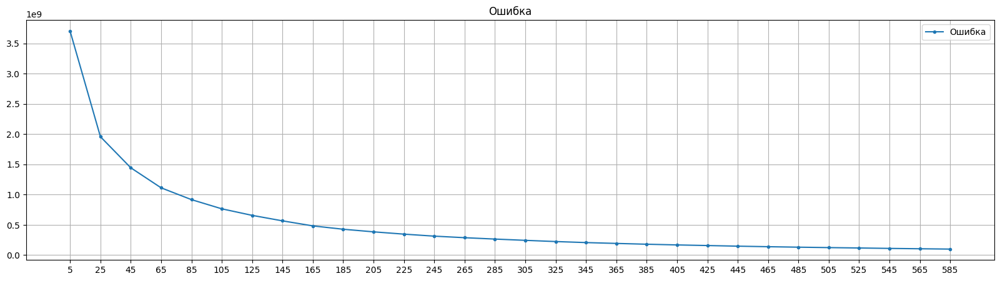

In [350]:
draw_chart(text_vec, 5, 600, 20)

In [352]:
kmeans_w2v = KMeans(n_clusters=405, n_init = 1, init='k-means++', random_state=42)
kmeans_w2v.fit(text_vec)
kmeans_w2v.inertia_

168752131.27007556

In [356]:
pca = PCA(n_components=2)
scatter = pca.fit_transform(X_text)

In [358]:
scatter

array([[-4416.00350469,  -842.56383005],
       [ 3304.82747892, -1294.2440291 ],
       [-1572.78915684,  2124.74710395],
       ...,
       [-4577.29882026,   416.82093858],
       [-2700.13260239,  -152.53603134],
       [-7766.92845852,  -598.30429139]])

<Axes: >

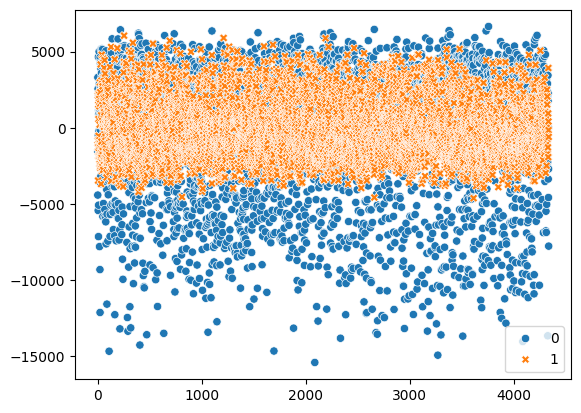

In [357]:
sns.scatterplot(scatter)

# FastText

In [370]:
X = df['text'].to_list()
tfidf_vectorizer = TfidfVectorizer(norm=None, ngram_range=(1, 1)) # No normalization
tfidf_vec = tfidf_vectorizer.fit_transform(X)
tfidf_vec.shape

(4337, 17885)

In [364]:
sentences = [sentence.split() for sentence in X]
ft_model = FastText(sentences=sentences, vector_size=vector_size, window=5, min_count=1, workers=4) # word_ngrams=2
# word_ngrams -In Facebook’s FastText, “max length of word ngram” 
# - but gensim only supports the default of 1 (regular unigram word handling).

In [365]:
ft_model.wv.key_to_index

{'время': 0,
 'человек': 1,
 'система': 2,
 'первый': 3,
 'большой': 4,
 'новый': 5,
 'работа': 6,
 'стать': 7,
 'использовать': 8,
 'очень': 9,
 'самый': 10,
 'иметь': 11,
 'являться': 12,
 'каждый': 13,
 'результат': 14,
 'модель': 15,
 'например': 16,
 'часть': 17,
 'учёный': 18,
 'исследование': 19,
 'несколько': 20,
 'получить': 21,
 'мир': 22,
 'должный': 23,
 'работать': 24,
 'случай': 25,
 'больший': 26,
 'процесс': 27,
 'проблема': 28,
 'вид': 29,
 'хороший': 30,
 'энергия': 31,
 'число': 32,
 'дать': 33,
 'некоторый': 34,
 'помощь': 35,
 'скорость': 36,
 'просто': 37,
 'сделать': 38,
 'звезда': 39,
 'именно': 40,
 'количество': 41,
 'однако': 42,
 'поэтому': 43,
 'разный': 44,
 'жизнь': 45,
 'компания': 46,
 'вода': 47,
 'земля': 48,
 'данные': 49,
 'говорить': 50,
 'высокий': 51,
 'объект': 52,
 'информация': 53,
 'друг': 54,
 'вопрос': 55,
 'уровень': 56,
 'задача': 57,
 'точка': 58,
 'любой': 59,
 'статья': 60,
 'нужно': 61,
 'место': 62,
 'делать': 63,
 'показать': 64,
 '

In [369]:
j = 0
for i in ft_model.wv.key_to_index.keys():
    if '_' in i or ' ' in i:
        print(i)
        j+=1

    if j >= 10:
        break

In [378]:
t2v = TextToVector(ft_model, text_len, vector_size, is_fasttext=True)
X_vec = t2v.convert(X)
X_vec[0].shape

(4337, 860, 50)

In [379]:
X_vec[1]

[['производство',
  'бриллиант',
  'стать',
  'дешёвый',
  'либо',
  'создавать',
  'странный',
  'проблема',
  'слишком',
  'бриллиант',
  'эпоха',
  'интернет',
  'купить',
  'практически',
  'угодный',
  'удивительный',
  'китайский',
  'сайт',
  'электронный',
  'коммерция',
  'приобрести',
  'станок',
  'изготовление',
  'бриллиант',
  'обращать',
  'внимание',
  'алмазный',
  'промышленность',
  'оказаться',
  'доступность',
  'машина',
  'отражать',
  'постоянный',
  'тенденция',
  'производство',
  'алмаз',
  'процесс',
  'начаться',
  'несколько',
  'десятилетие',
  'назад',
  'продолжать',
  'развиваться',
  'изображение',
  'станок',
  'производство',
  'синтетический',
  'алмаз',
  'press',
  'изготовить',
  'компания',
  'co',
  'ltd',
  'китай',
  'история',
  'бриллиант',
  'вырастить',
  'лаборатория',
  'насчитывать',
  'менее',
  'полвека',
  'слово',
  'аспирант',
  'гарвард',
  'написать',
  'обширный',
  'статья',
  'вырастить',
  'лаборатория',
  'алмаз',
  'опубл

In [380]:
to1vec = To1Vec(tfidf_vectorizer)
X_text = to1vec.convert(X_vec[0], X_vec[1])
X_text.shape

(4337, 50)

In [381]:
X_text[0]

array([ 1377.0215045 ,  1826.13373202,   275.51669609,  -646.75780977,
       -1493.0145194 ,  1155.41270647,   882.40932427,  2195.87579806,
        2433.17944612,    20.80156633,  -808.29857041, -1290.71544064,
        1696.44273278, -1205.25493704,  -152.76857085,  -509.34417928,
         718.78764146, -1295.82543488, -2134.36083594, -2747.5635924 ,
        1220.72208257,  2011.24661278, -1043.71837315,   959.5620283 ,
         865.32823131,  3801.61201033,  1490.18745197,  -516.6740048 ,
        -139.93488149,  -775.98411653,   545.89505993,  1293.21924282,
       -1077.46650241, -4102.93474204, -4472.89525086,  -134.67822954,
        1525.31186599,  3025.46231655, -3707.8311004 , -2954.11453513,
       -1852.81802476,  1829.00501035,  2569.50304469,  1704.88724481,
        -459.73323538,  2067.04531122, -1387.17917455,    99.19900198,
         422.86103599,  -245.04688506])

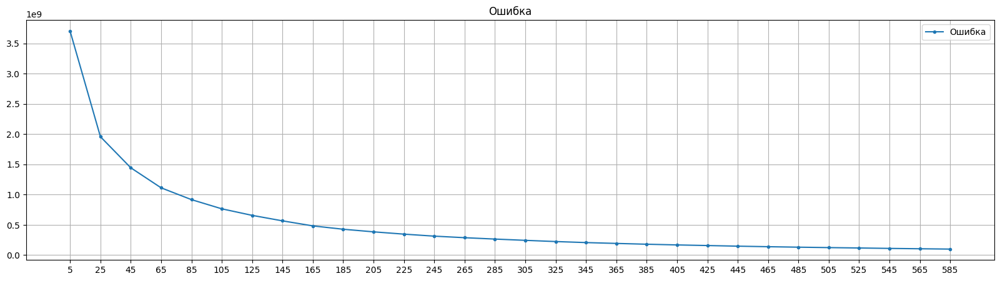

In [382]:
draw_chart(text_vec, 5, 600, 20)

In [386]:
kmeans_ft = KMeans(n_clusters=345, n_init = 1, init='k-means++', random_state=42)
kmeans_ft.fit(text_vec)
kmeans_ft.inertia_

207625528.87864262

In [383]:
pca = PCA(n_components=2)
scatter = pca.fit_transform(X_text)

In [384]:
scatter

array([[  2600.52847916,   4550.48711523],
       [  1311.24982806,  -2658.30191498],
       [-10939.60111074,    167.62634048],
       ...,
       [ -4603.90634472,   6092.09284801],
       [  1177.80319545,   4267.75963323],
       [  3359.79154257,   7128.89320963]])

<Axes: >

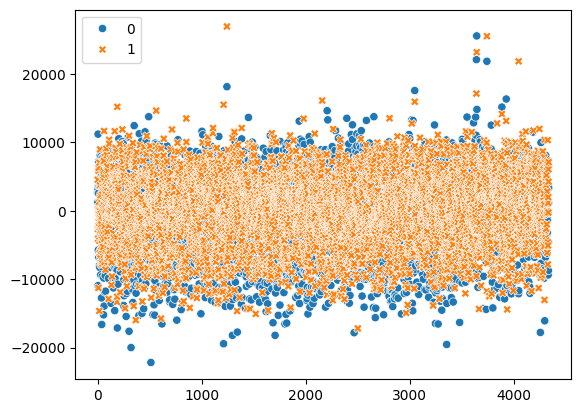

In [385]:
sns.scatterplot(scatter)